In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from skimage.filters import meijering, sato, frangi, hessian
from skimage.measure import label, regionprops
from sklearn import decomposition
from scipy.ndimage import gaussian_filter
from scipy.signal import find_peaks
# import tifffile
# import rasterio

In [2]:
import skimage
skimage.__version__

'0.18.1'

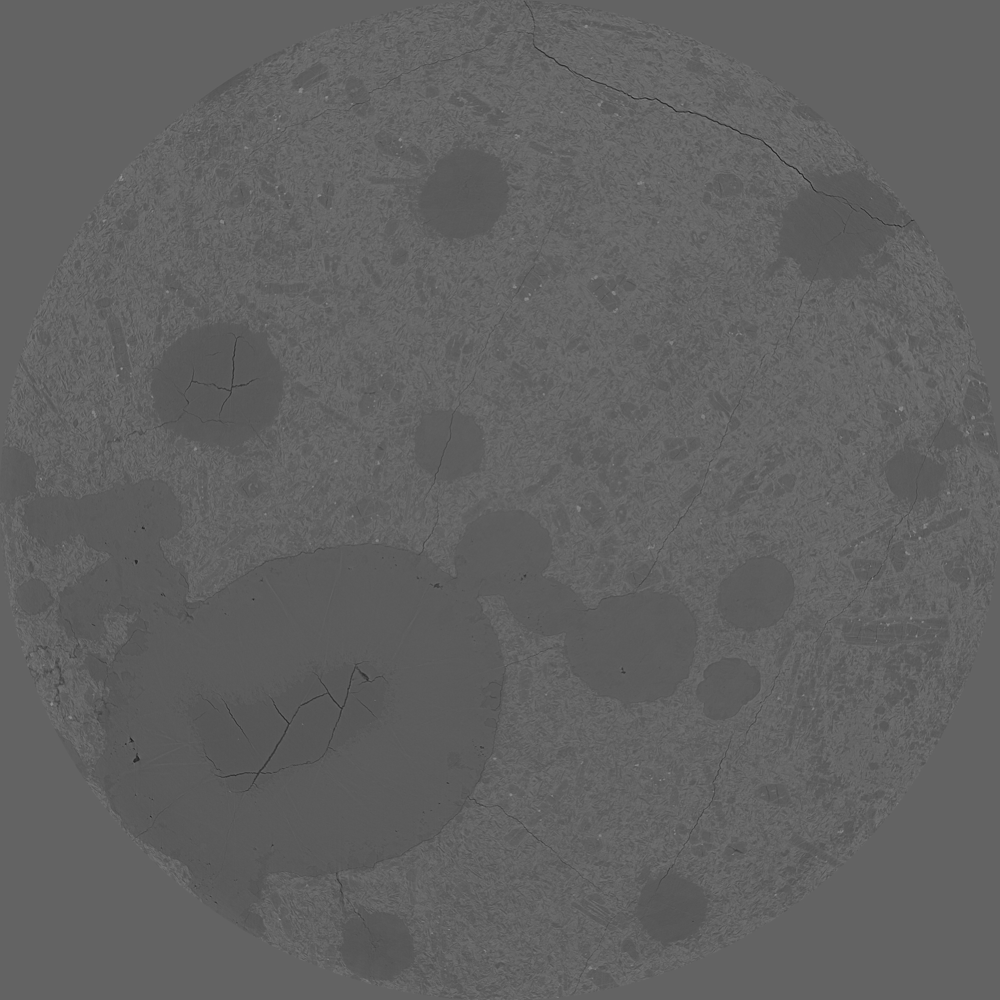

In [3]:
# im = Image.open('benoitdata/F20_10_b/6um_jamtveit_att_pag-1.99_3.12_00225.tif')
# filename = r'benoitdata/6um_jamtveit_att_pag-1.99_3.12_00225.tiff'
# filename = 'benoitdata/F20_10_b/6um_jamtveit_att_pag-1.99_3.12_00005.tif'
filename = 'benoitdata/F20_10_b/6um_jamtveit_att_pag-1.99_3.12_00030.tif'
im = Image.open(filename)
# im = tifffile.imread(filename)
# src = rasterio.open(filename)
imarr = np.array(im)
im

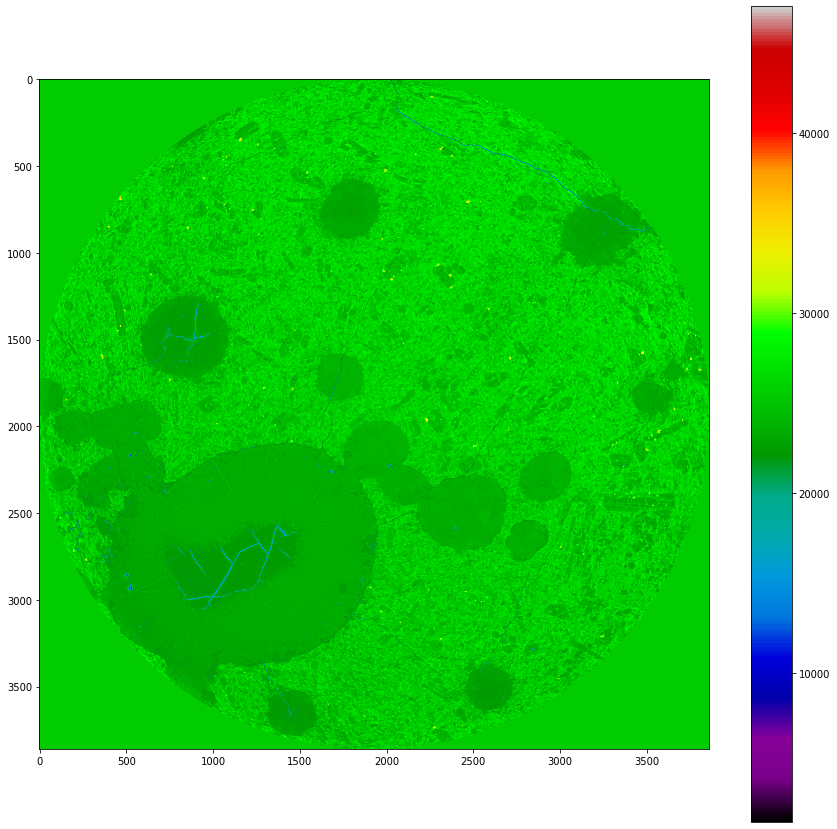

In [4]:
fig, ax = plt.subplots(figsize=(15, 15))
cbar = ax.imshow(imarr, cmap='nipy_spectral')
fig.colorbar(cbar)

In [5]:
# """
# creates a mask based on the radius of the sample to remove
# outlying data in the scan which is meaningless and not part
# of the sample
# """

# x = np.arange(imarr.shape[0])
# y = np.arange(imarr.shape[1])

# cx = imarr.shape[0] // 2
# cy = imarr.shape[1] // 2
# r = imarr.shape[0] // 2

# mask = (x[np.newaxis,:] - cx)**2 + (y[:, np.newaxis] - cy)**2 > r**2

# imarr_maskradius = imarr.astype(np.float64)
# imarr_maskradius[mask] = np.nan 

def remove_data_based_on_radius(data, mask_value=-1):
    """
    creates a mask based on the radius of the sample to remove
    outlying data in the scan which is meaningless and not part
    of the sample
    """
    x = np.arange(data.shape[0])
    y = np.arange(data.shape[1])
    
    cx = data.shape[0] // 2
    cy = data.shape[1] // 2
    r = data.shape[0] // 2
    
    mask = (x[np.newaxis,:] - cx)**2 + (y[:, np.newaxis] - cy)**2 > r**2
    
    data_maskradius = data.astype(np.float64)
    data_maskradius[mask] = mask_value
    
    return data_maskradius

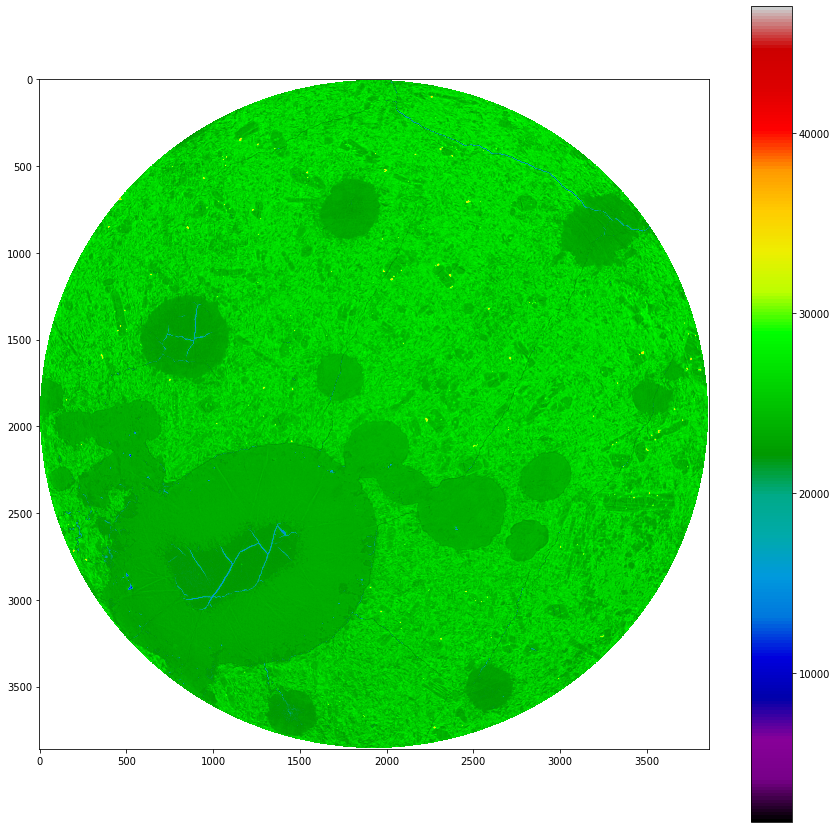

In [6]:
imarr_maskradius = remove_data_based_on_radius(imarr, mask_value=np.nan)

fig, ax = plt.subplots(figsize=(15, 15))
cbar = ax.imshow(imarr_maskradius, cmap='nipy_spectral')
fig.colorbar(cbar)

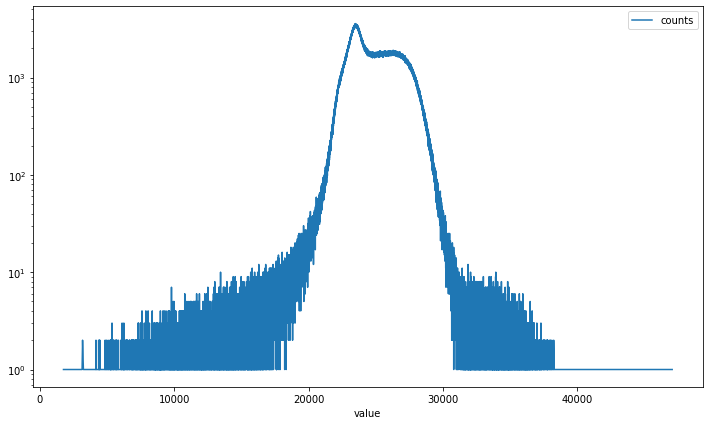

In [7]:
value, counts = np.unique(imarr_maskradius, return_counts=True)
histdf = pd.DataFrame({'value':value, 'counts':counts}).sort_values(by='value')

fig, ax = plt.subplots(figsize=(12, 7))
histdf.plot(x='value', y='counts', ax=ax)
ax.set_yscale('log')

In [8]:
imarr_blur = gaussian_filter(imarr_maskradius, sigma=1)

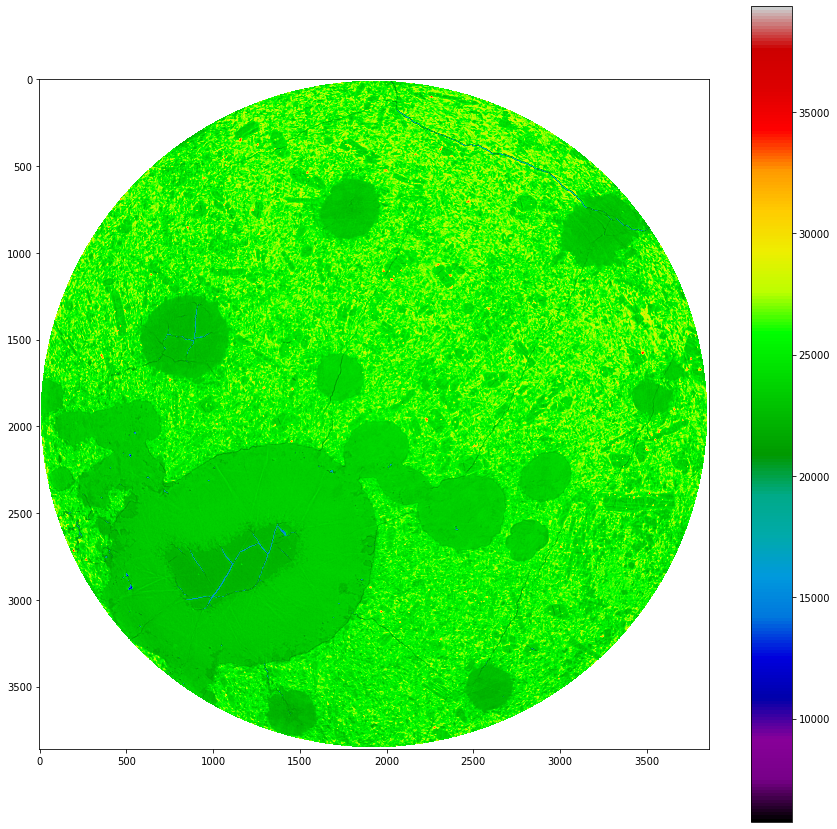

In [9]:
fig, ax = plt.subplots(figsize=(15, 15))
cbar = ax.imshow(imarr_blur, cmap='nipy_spectral')
fig.colorbar(cbar)

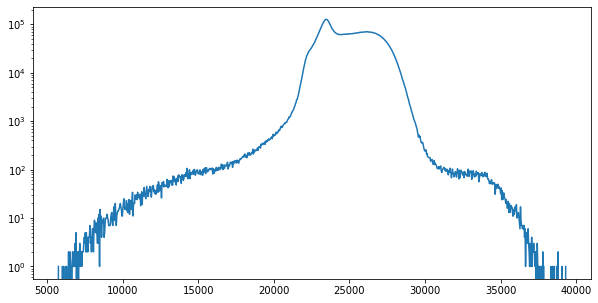

In [10]:
h, e = np.histogram(imarr_blur[~np.isnan(imarr_blur)].flatten(), bins=1000)

fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(e[:-1], h)
ax.set_yscale('log')

In [11]:
peaks, other = find_peaks(h, height=1e3, width=4)

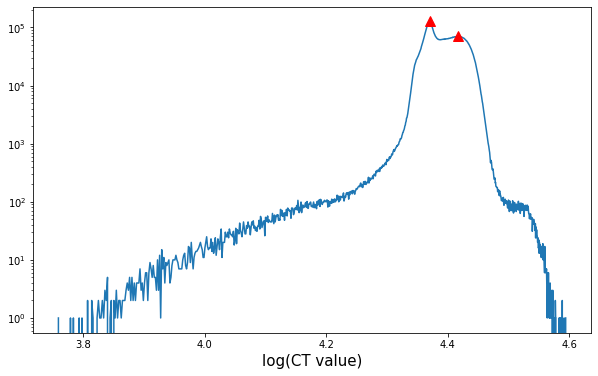

In [12]:
fig, ax = plt.subplots(figsize=(10, 6))

x = np.log10(e[:-1])

ax.plot(x, h)
ax.set_yscale('log')
ax.set_xlabel('log(CT value)', fontsize=15)
# ax.set_ylim(1e1, 1e8)

ax.plot(x[peaks], h[peaks], marker='^', markersize=10, linewidth=0, color='red')

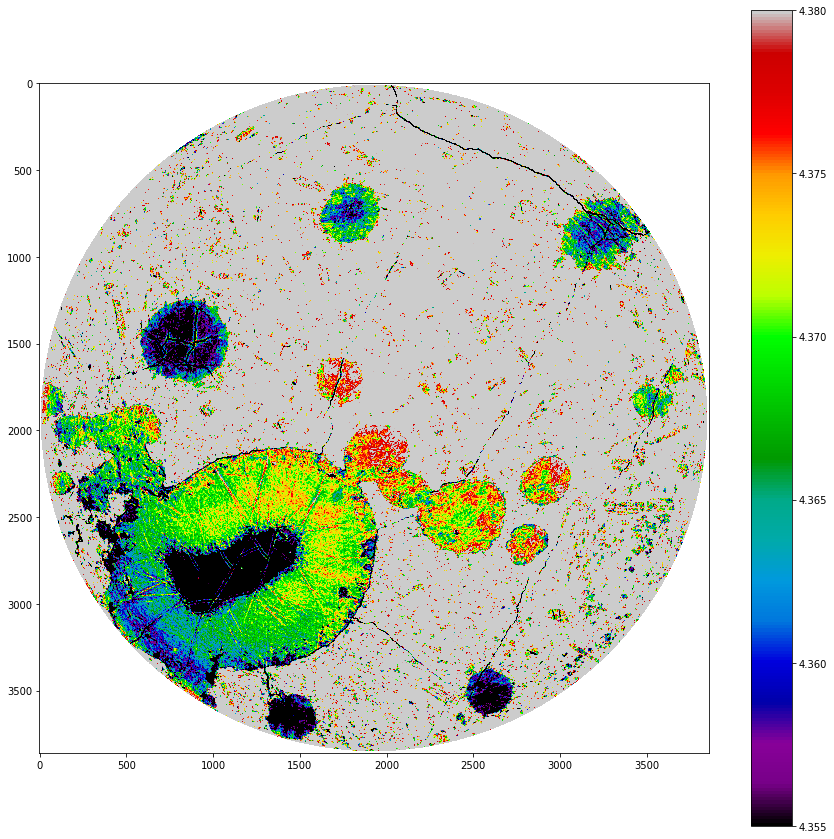

In [13]:
fig, ax = plt.subplots(figsize=(15, 15))

cbar = ax.imshow(np.log10(imarr_blur), cmap='nipy_spectral', vmin=4.355, vmax=4.38)

fig.colorbar(cbar)

In [14]:
h = hessian(imarr_blur, sigmas=[2, 2])

/home/john/anaconda3/envs/faroe/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Previously, hessian implicitly used 'constant' as the border mode when dealing with the edge of the array. The new behavior is 'reflect'. To recover the old behavior, use mode='constant'. To avoid this warning, please explicitly set the mode.
  """Entry point for launching an IPython kernel.


In [15]:
l = label(h)

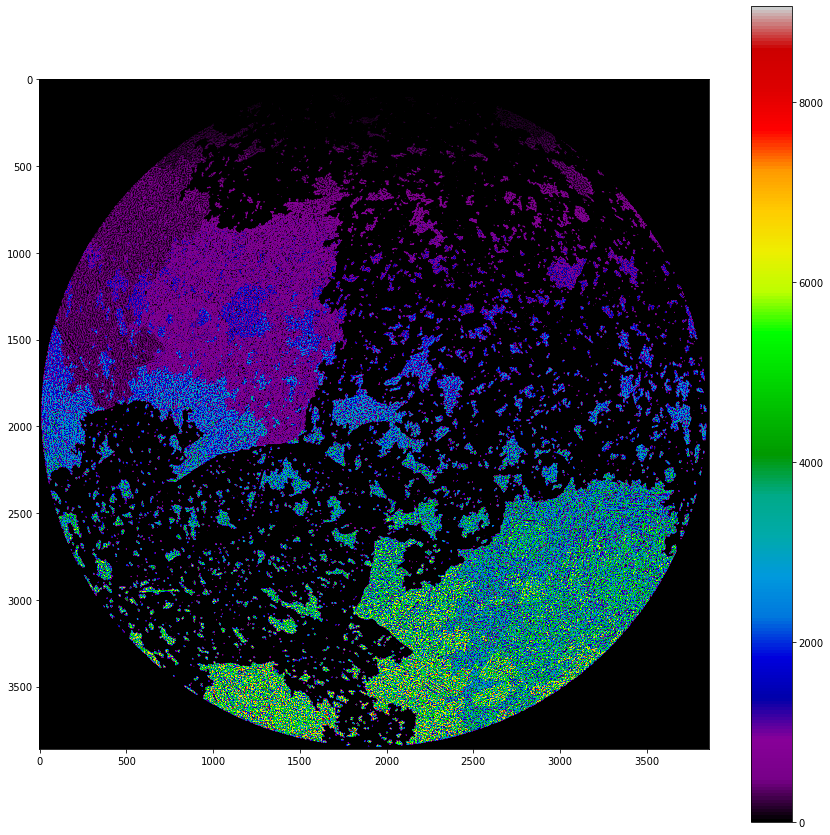

In [16]:
fig, ax = plt.subplots(figsize=(15, 15))

cbar = ax.imshow(l, cmap='nipy_spectral')

fig.colorbar(cbar)

In [17]:
from sklearn.preprocessing import StandardScaler

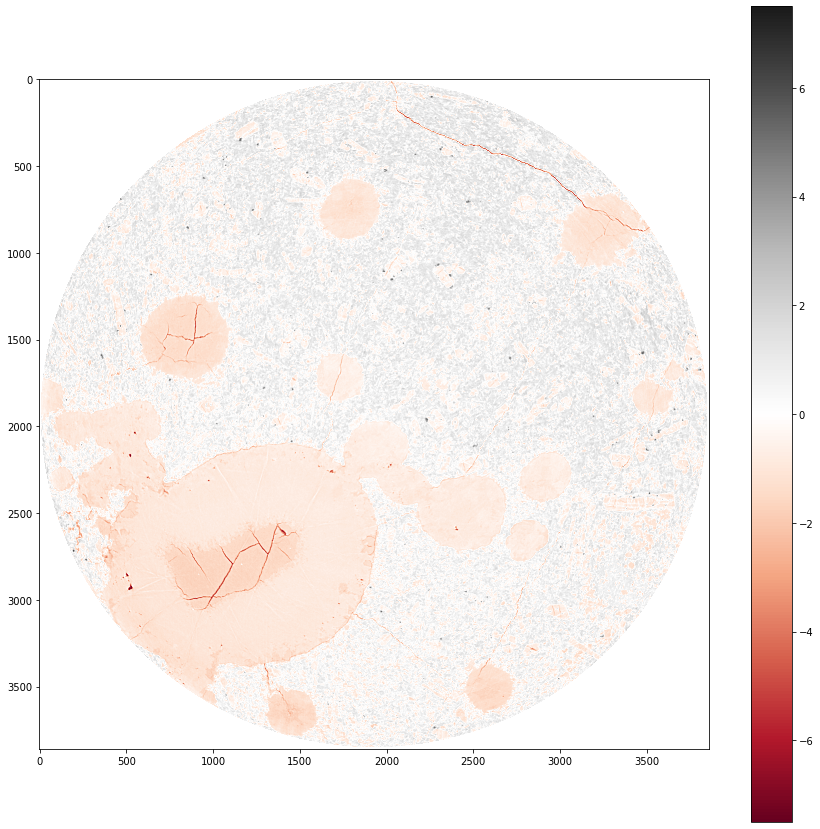

In [18]:


def zscore(data):
    
    data_flat = data.flatten()
    data_flat = data_flat[~np.isnan(data_flat)]
    
    mean = np.mean(data_flat)
    std = np.std(data_flat)
    
    return (data - mean)/std


zim = zscore(imarr_blur)

fig, ax = plt.subplots(figsize=(15, 15))

cbar = ax.imshow(zim, cmap='RdGy', vmin=-7.5, vmax=7.5)

fig.colorbar(cbar)

In [19]:
# fig, ax = plt.subplots(figsize=(15, 15))

# cbar = ax.imshow(imarr_blur - np.mean(imarr_blur.flatten()), cmap='nipy_spectral')

# fig.colorbar(cbar)

In [20]:
np.mean(imarr_blur.flatten())

nan

In [21]:
from skimage import data

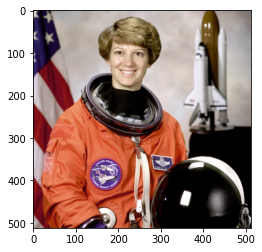

In [22]:
plt.imshow(data.astronaut())